In [41]:
import glob
import math
import numpy as np
import metrics.visual as vis
from visualize.show_img import blend_red
import preproc.get_data as data

In [42]:
import importlib
importlib.reload(vis)

<module 'metrics.visual' from '/Users/remogeissbuehler/myCloud/Uni/CIL/fs20_cil_road_segmentation/metrics/visual.py'>

In [43]:
files = glob.glob('files_to_compare/*.csv')

h = 16
w = h
imgwidth = int(math.ceil((600.0/w))*w)
imgheight = int(math.ceil((600.0/h))*h)
nc = 3

In [44]:
preds = {}

for file in files:
    preds_for_this_file = {}
    print("\r " + file, end='')
    f = open(file)
    lines = f.readlines()
    for i in range(1, len(lines)):
        line = lines[i]

        tokens = line.split(',')
        id = tokens[0]
        prediction = int(tokens[1])

        tokens = id.split('_')
        id = tokens[0]
        i = int(tokens[1])
        j = int(tokens[2])

        if id not in preds_for_this_file:
            preds_for_this_file[id] = np.zeros((imgwidth, imgheight), dtype=np.float32)


        je = min(j + w, imgwidth)
        ie = min(i + h, imgheight)
        if prediction == 0:
            adata = np.zeros((w, h))
        else:
            adata = np.ones((w, h))

        preds_for_this_file[id][j:je, i:ie] = adata
    f.close()
    preds[file] = preds_for_this_file

print('\nread all files')


 files_to_compare/ckp_cnn_dice_SPECIALDATA.csvion_small_e27.csv
read all files


In [45]:
x_test, x_test_names = data.get_test_data()

In [46]:
import importlib
importlib.reload(vis)

<module 'metrics.visual' from '/Users/remogeissbuehler/myCloud/Uni/CIL/fs20_cil_road_segmentation/metrics/visual.py'>

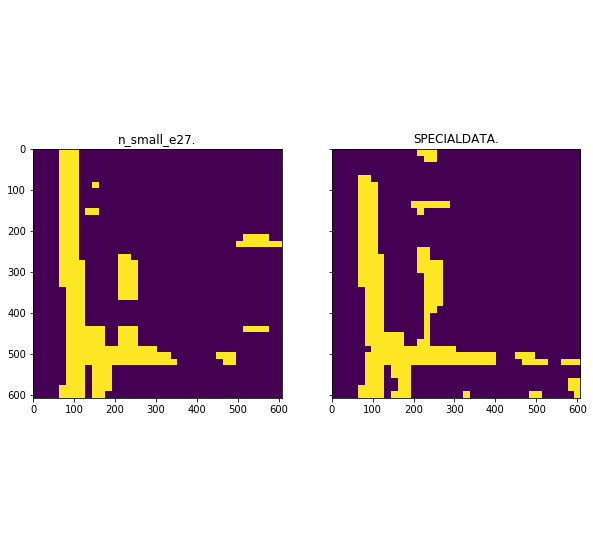

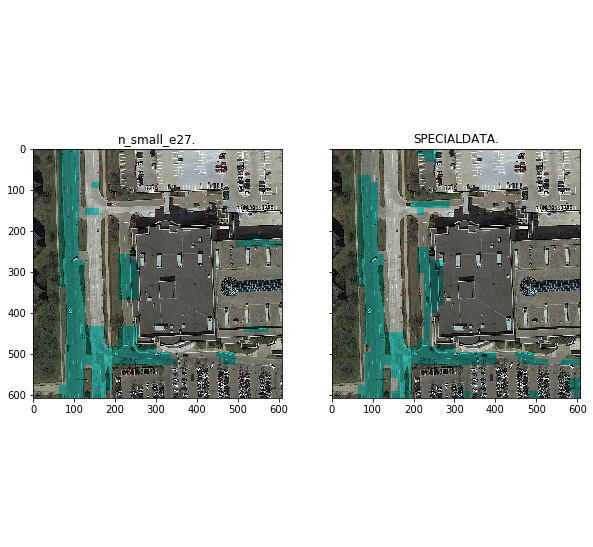

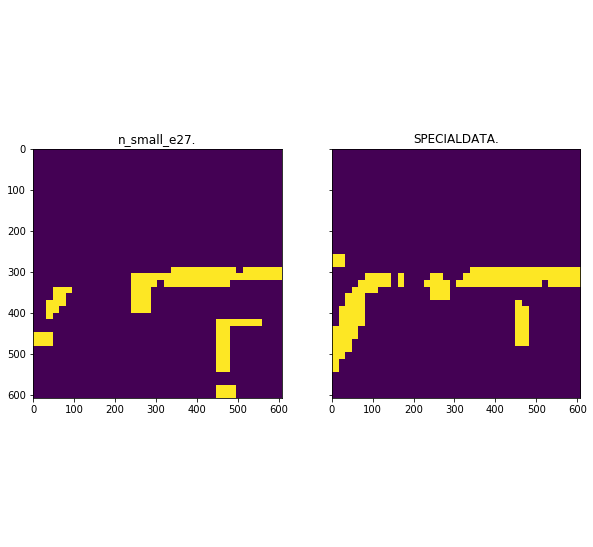

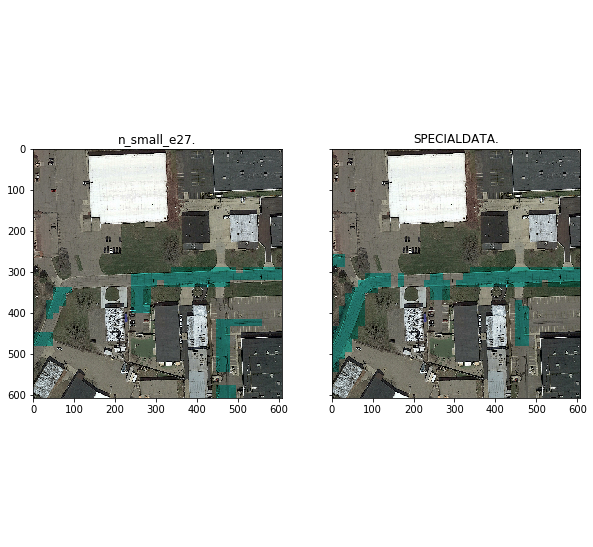

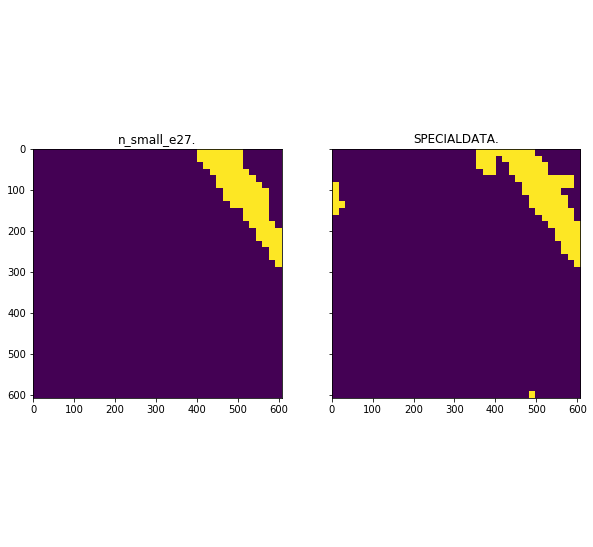

...

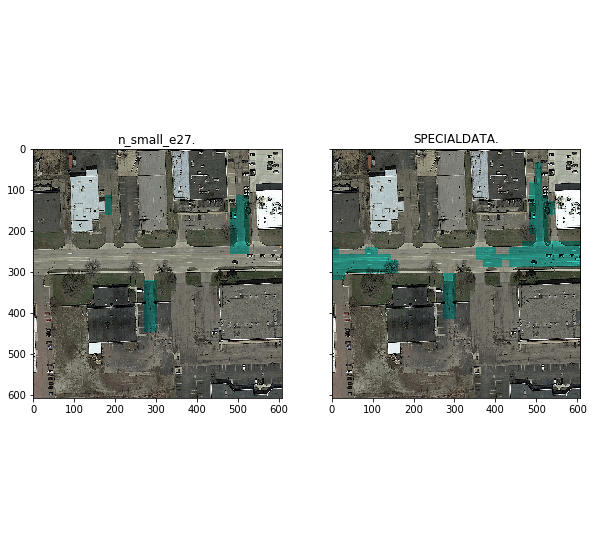

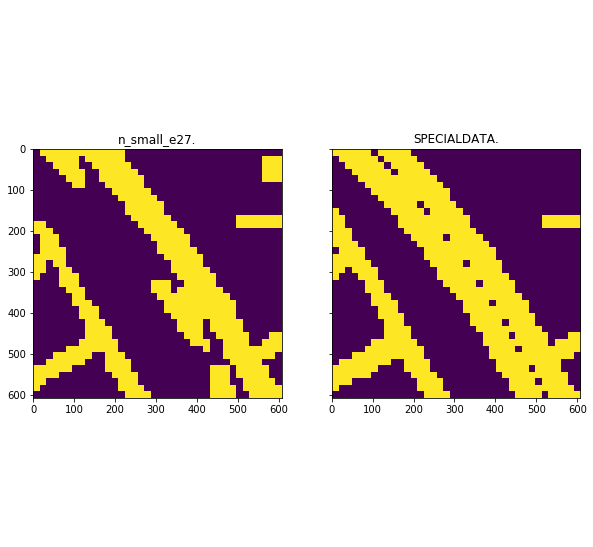

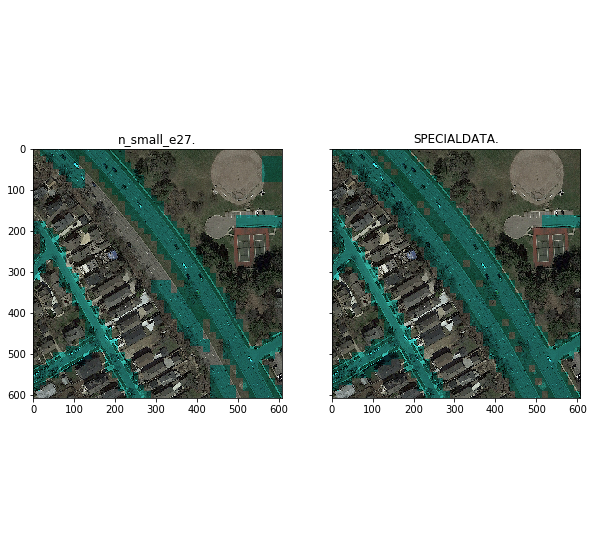

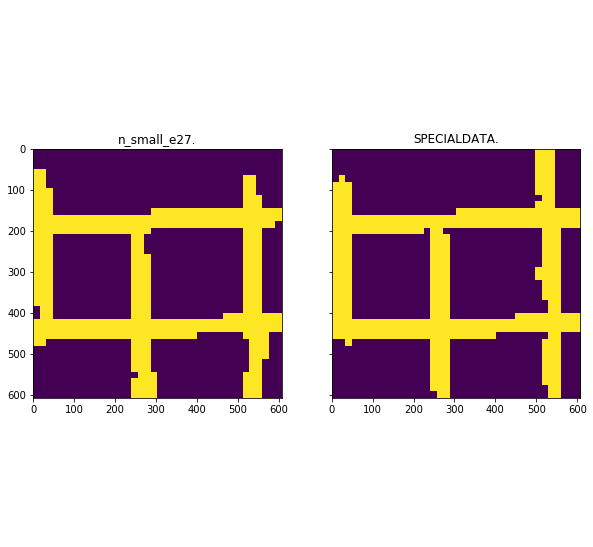

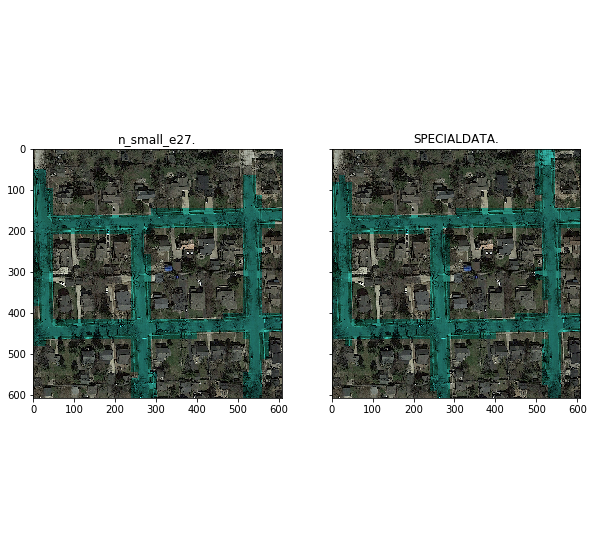

In [47]:
i = 0
for key, _ in sorted(map(lambda x: (str(int(x[0])), x[1]), preds[files[0]].items())):
    key = '%03d' % int(key)
    vis.plot([ preds[f][key] for f in files], labels=[f[-15:-3] for f in files])
    vis.plot([blend_red(x_test[i], preds[f][key]) for f in files], labels=[f[-15:-3] for f in files])
    i += 1